In [1]:
# set main directory name
dir = dirname(pwd());

In [13]:
using DifferentialEquations
using JumpProcesses
using Plots
# using PlotlyJS
using Statistics
using Distributions
using Random
using JLD2

using Optimization
using OptimizationOptimJL
using ForwardDiff
# using BlackBoxOptim

using CSV
using DataFrames
using DelimitedFiles

using HDF5
using MCMCChains
using StatsPlots

# include own module with functionalities
include(joinpath(dir, "src/functionalities.jl"))


# set seed for reproducibility
Random.seed!(123);

## Gompertz growth model
Instead of a exponential growth, we can also consider a gompert ODE of the form (introduced by A.K.Laird for tumor growth in 1960s)
$$
\frac{dS}{dt}=\alpha \ln\left(\frac{K}{S(t)}\right) S(t)
$$
which has the solution
$$
S(t)= K \exp\left(\ln\left(\frac{S_0}{K}\right)\exp(-\alpha t)\right)
$$
where $K$ is the carrying capacity and sets the asymptote and $\alpha$ a constant related to the proliferative ability of the cells. (Note, that there are many different parametrizations for different interpretations as shown in Tjorve.)

### Simulation of some patient data

In [3]:
# realistic S0 in mm³
S0 = 0.065

0.065

In [4]:
# set parameter sets
β_set = [0.48, 0.49, 0.5, 0.51, 0.52]
K_set = [150000, 150000, 150000, 150000, 150000]
α_set = [0.14, 0.17, 0.2, 0.24, 0.3]

5-element Vector{Float64}:
 0.14
 0.17
 0.2
 0.24
 0.3

In [8]:
function GompertzSolution(t, S0, K, α)
    return K * exp(log(S0/K) * exp(-α * t))
end


plt = plot()
plot!(plt, 0:0.01:30, t -> GompertzSolution(t, S0, K_set[1], α_set[1])./1000, linewidth=2, label="Gompertz growth", color=:darkorange3, alpha=0.5)
plot!(plt, 0:0.01:30, [S0 * exp(β_set[1]*t)/1000 for t in 0:0.01:30], linewidth=2, label="Exponential growth", color=:lightblue4, alpha=0.5)

for (β, K, α) in zip(β_set[2:end], K_set[2:end], α_set[2:end])
    plot!(plt, 0:0.01:30, t -> GompertzSolution(t, S0, K, α)./1000, linewidth=2, label="", color=:darkorange3, alpha=0.5)
    plot!(plt, 0:0.01:30, [S0 * exp(β*t)/1000 for t in 0:0.01:30], linewidth=2, label="", color=:lightblue4, alpha=0.5)
end

plot!(plt, xlabel="Time (months)", ylabel="Tumor volume (cm³)", legendfontsize = 12, guidefontsize = 14, tickfontsize = 12, legend=:topleft)

# savefig(plt, joinpath(dir, "figures/tumour_growth_curves.pdf"))


"/home/vincent/PhD/Projects/Combined_Stochastic_Model1/figures/tumour_growth_curves.pdf"

In [10]:
include("general_MNR_simulation_algorithm.jl")

function TumorPath(S0, p; endtime=30.0)
    prob = ODEProblem(GompertzODE!, [S0], (0.0, endtime), [p.K, p.α])
    sol = solve(prob, Tsit5(), reltol=1e-8, abstol=1e-8)
    return sol
end

# set parameters
K = 150000
α = 0.2
S0 = 0.065
endtime = 30
p = (K=K, α=α, m_basal = 0.01, m_size = 0.001, d_size = 0.0003, d_metastasis = 0.003)
θ = [K, α, 0.01, 0.001, 0.0003, 0.003]
true_par = θ

npat = 500

# gompertz_patient_df = simulate_many_MNR(p, TumorPath, npat = npat);


500

In [14]:
# save the data
# save(joinpath(dir, "data/gompertz_data_$(npat)_patients_$(θ).jld2"), "gompertz_data", gompertz_patient_df)

# load the data
npat = 500
gompertz_patient_df = load(joinpath(dir, "data/gompertz_data_$(npat)_patients_$(θ).jld2"))["gompertz_data"]
data_summary(gompertz_patient_df)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 17.3554
  "Low Quantile survival time:"  => 13.1257
  "Mean metastasis at day 10:"   => 0.479029
  "Mean metastasis at death:"    => 2.55251
  "Mean tumor size at day 10:"   => 19948.8
  "High Quantile survival time:" => 21.4367
  "Maximal metastasis number:"   => 13
  "Mean metastasis at day 20:"   => 3.02899
  "Patients died:"               => 438
  "Maximum metastasis increase:" => 4

In [82]:
sparse_data = DataFrame(patient_id = Int[], time = Float64[], tumor = Float64[], metastasis = Int[], death = Int[])
for id in unique(gompertz_patient_df.patient_id)
    patient_data = gompertz_patient_df[gompertz_patient_df.patient_id .== id, :]
    len = size(patient_data, 1)
    new_patient_data = patient_data[sample(axes(patient_data, 1), ceil(Int, len/2); replace = false, ordered = true), :]
    # check if deathpoint is in there
    if sum(new_patient_data.death) == 0
        # if not, add it
        death_data = patient_data[patient_data.death .== 1, :]
        append!(new_patient_data, death_data)
    end
    append!(sparse_data, new_patient_data)
end

In [83]:
data_summary(sparse_data)

Dict{String, Real} with 10 entries:
  "Mean survival time:"          => 17.3554
  "Low Quantile survival time:"  => 13.1257
  "Mean metastasis at day 10:"   => 0.489083
  "Mean metastasis at death:"    => 2.55251
  "Mean tumor size at day 10:"   => 19791.5
  "High Quantile survival time:" => 21.4367
  "Maximal metastasis number:"   => 13
  "Mean metastasis at day 20:"   => 3.06931
  "Patients died:"               => 438
  "Maximum metastasis increase:" => 5

In [84]:
# # save sparse data
# data_path = joinpath(dir, "data/sparse_gompertz_data_$(npat)_patients_$(θ)_promise2.jld2")
# save(data_path, "sparse_gompertz_data", sparse_data)

In [43]:
# data_path = joinpath(dir,"data/sparse_gompertz_data_$(npat)_patients_$(θ)_promise2.jld2")
# sparse_data = load(data_path)["sparse_gompertz_data"];

## Inference
We use numeric integration to approximate the likelihood.

In [17]:
using BenchmarkTools

include(joinpath(dir, "src/GompertzLikelihoods.jl"))
import .GompertzLikelihoods as GL

In [18]:
using LatinHypercubeSampling

log_lb_x0 = [11.849, -1.75, -7, -9, -9, -9]
log_ub_x0 = [11.983, -1.5, -2, -4, -6, -4]

n_starts = 100 

plan,_ = LHCoptim(n_starts, length(log_lb_x0), 1000)
scaled_plan = scaleLHC(plan, [(log_lb_x0[i], log_ub_x0[i]) for i in eachindex(log_lb_x0)]);

x0_vectors = [scaled_plan[i, :] for i in 1:size(scaled_plan, 1)];

# save startpoints
# save("data/startpoints_gompertz_likelihoods_$(n_starts)_starts_$(npat)_patients_$(θ).jld2", "startpoints", x0_vectors)

x0_vectors = load(joinpath(dir, "data/startpoints_gompertz_likelihoods_$(n_starts)_starts_$(npat)_patients_$(θ).jld2"))["startpoints"];

In [27]:
gompertzOptim(x, p) = GL.TumorNegLogLikelihood(x[1], x[2], gompertz_patient_df)
gompertzOptimFunc = OptimizationFunction(gompertzOptim, Optimization.AutoForwardDiff())
gompertzOptimProblem = OptimizationProblem(gompertzOptimFunc, [150000, 0.18], lb=zeros(2).+1e-4, ub=[300000, 1])
gompertzEst = solve(gompertzOptimProblem, LBFGS(), maxiters=10^5)
println("K:", gompertzEst[1], "\n", "α:", gompertzEst[2], "\n")

K:150466.08146347356
α:0.19994941804484753



In [28]:
metOptim(x, p) = GL.MetastasisNegLogLikelihood([gompertzEst[1], gompertzEst[2], x[1], x[2]], gompertz_patient_df)
metOptimFunc = OptimizationFunction(metOptim, Optimization.AutoForwardDiff())
metOptimProblem = OptimizationProblem(metOptimFunc, [0.1, 0.1], lb=zeros(2).+1e-4, ub=ones(2))
metEst = solve(metOptimProblem, LBFGS(), maxiters=10^5)
println("Metastasis:", metEst, "\n")

Metastasis:retcode: Success
u: [0.007247471973386913, 0.0010207951881728242]
Final objective value:     3957.78170438153




In [29]:
deathOptim(x, p) = GL.DeathNegLogLikelihood([gompertzEst[1], gompertzEst[2], metEst[1], metEst[2], x[1], x[2]], gompertz_patient_df, S0=0.065)
deathOptimFunc = OptimizationFunction(deathOptim, Optimization.AutoForwardDiff())
deathOptimProblem = OptimizationProblem(deathOptimFunc, [0.005, 0.005], lb=zeros(2).+1e-4, ub=ones(2))
deathEst = solve(deathOptimProblem, SAMIN(), maxiters=10^6)
println("Death:", deathEst, "\n")
est_par = [gompertzEst[1], gompertzEst[2], metEst[1], metEst[2], deathEst[1], deathEst[2]]

SAMIN results
==> Normal convergence <==
total number of objective function evaluations: 20901

     Obj. value:   1571.5032912404

       parameter      search width
         0.00027           0.00000 
         0.00326           0.00000 

Death:retcode: Failure
u: [0.00027268303160805766, 0.0032581606844865984]
Final objective value:     1571.5032912403665




6-element Vector{Float64}:
 150466.08146347356
      0.19994941804484753
      0.007247471973386913
      0.0010207951881728242
      0.00027268303160805766
      0.0032581606844865984

In [ ]:
# load optimization result
nstarts = 100
optimizer = "SAMIN"
Llh_Type = "Numeric"
gompertz_result_path = joinpath(dir,"output/gompertz_joined_optimization_$(nstarts)_starts_$(optimizer)_distributed_$(Llh_Type).jld2")
gompertz_results = load(gompertz_result_path)["results"]
gompertz_par_names = gompertz_results["par_names"]
gompertz_results = gompertz_results["optimization_results"]
gompertz_nllhs_list = [gompertz_results[i]["nllh"] for i in 1:nstarts]
gompertz_par_list = [gompertz_results[i]["parameter"] for i in 1:nstarts];
gompertz_mean_time = mean([gompertz_results[i]["time_trace"][end] for i in 1:nstarts])
gompertz_max_time = maximum([gompertz_results[i]["time_trace"][end] for i in 1:nstarts])

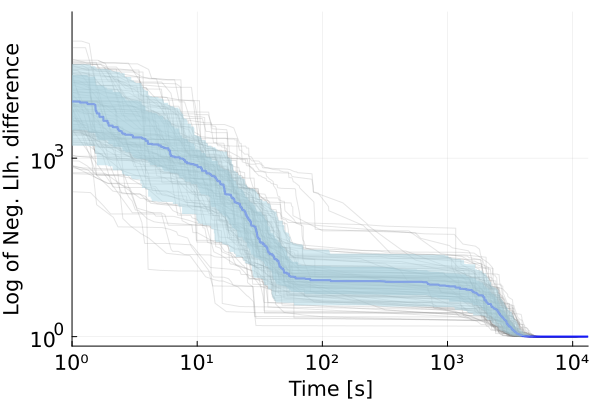

In [20]:
optimizer ="SAMIN"
nstarts = 100
Llh_type = "Numeric"
xlimits = (0.0, log10(gompertz_max_time))

optimizer_trace_plots(gompertz_results, xlim=xlimits)
# savefig(joinpath(dir, "figures/trace_plot_gompertz_$(nstarts)_starts_$(optimizer)_$(Llh_type).pdf"))

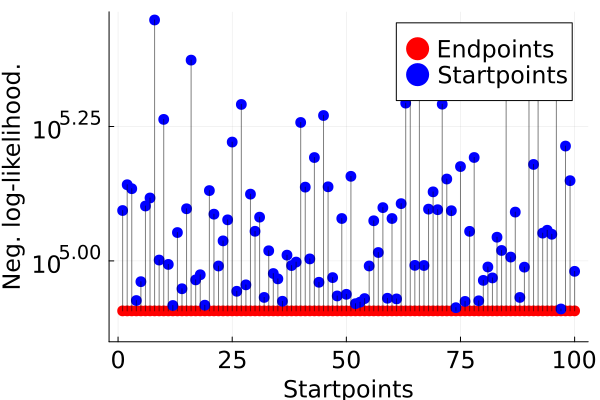

"/home/vincent/PhD/Projects/method_project/second_model/figures/ode_paper/double_waterfall_plot_gompertz_joined_optimisation_SAMIN_100_starts_Numeric.pdf"

In [25]:
# plot waterfall plot
x0_nllhs = [GL.NegLogLikelihood(exp.(x0_vectors[i]) , gompertz_patient_df, S0=0.065) for i in 1:nstarts];
cg = cgrad(:hsv, range(0, 1, length=nstarts))

perm = sortperm(gompertz_nllhs_list)
gompertz_nllhs_list .= gompertz_nllhs_list[perm]
gompertz_par_list .= gompertz_par_list[perm]

# set grouping by fval for color
rel_threshold = 1
k = 1
z = zeros(nstarts)
for i in 1:nstarts
    if i == 1
        z[i] = k
    else
        if gompertz_nllhs_list[i] - gompertz_nllhs_list[i-1] <= rel_threshold
            z[i] = k
        else
            k = k + 1
            z[i] = k
        end
    end
end

# cg = cgrad(:hsv, range(0, 1, length=Int(z[end])))
gr(markerstrokewidth=0,markersize=6)
plt = Plots.plot(gompertz_nllhs_list, linecolor=:black,label=false,  yscale=:log10, legend=:best)
Plots.scatter!(plt, 1:1:100, gompertz_nllhs_list,  color=cg[Int.(z)], markershape=:circle, label="Endpoints")
scatter!(plt, 1:1:100, x0_nllhs, color=:blue, label="Startpoints")
for i in 1:n_starts
    plot!(plt, [i, i], [x0_nllhs[i], gompertz_nllhs_list[i]], color=:black, label=false, alpha=0.5)
end
plot!(plt, legendfontsize=16, tickfontsize=16, guidefontsize=16, xlabel="Startpoints", ylabel="Neg. log-likelihood.", ylimit=(gompertz_nllhs_list[1]-10000, maximum(x0_nllhs)+10000))
display(plt)
optimizer = "SAMIN"
nstarts = 100
Llh_type = "Numeric"
savefig(joinpath(dir, "figures/double_waterfall_plot_gompertz_joined_optimisation_$(optimizer)_$(nstarts)_starts_$(Llh_type).pdf"))

### Sampling
After getting the MLE point estimates we perform sampling for uncertainty quantification and to retrieve credibility intervals for our estimates.

In [22]:
using MCMCChains
using StatsPlots

In [23]:
function dict_to_chain(
    result_dict,
    par_names,
    n_chains,
    n_iter
)
    chs = Array{Float64}(undef, n_iter+1, length(par_names), n_chains)
    for i in 1:n_chains
        ch = Array{Float64}(undef, n_iter+1, length(par_names))
        for id in eachindex(par_names)
            par = par_names[id]
            ch[:, id] = result_dict["parameters"][par][:,i]
        end
        chs[:, :, i] = ch
    end

    return Chains(chs, par_names)
end

dict_to_chain (generic function with 1 method)

In [25]:
# load result hdf5 file
n_iter = 100000
n_chains = 10
result_path = joinpath(dir, "output/sampling_gompertz_$(n_chains)chs_$(n_iter)it_$(θ).h5")
chain_dict = h5open(result_path, "r") do file
    read(file,)
end
chain = dict_to_chain(chain_dict, ["K", "alpha", "m_basal", "m_size", "d_size", "d_metastasis"], n_chains, n_iter)

Chains MCMC chain (100001×6×10 Array{Float64, 3}):

Iterations        = 1:1:100001
Number of chains  = 10
Samples per chain = 100001
parameters        = K, alpha, m_basal, m_size, d_size, d_metastasis

Summary Statistics
    parameters          mean        std      mcse     ess_bulk     ess_tail    ⋯
        Symbol       Float64    Float64   Float64      Float64      Float64    ⋯

             K   150452.0857   296.5171    2.3765   16052.6974   68064.3945    ⋯
         alpha        0.2000     0.0001    0.0000   21295.1078   42961.5875    ⋯
       m_basal        0.0076     0.0022    0.0000   41953.2339   78459.1953    ⋯
        m_size        0.0010     0.0000    0.0000   53108.8756   88153.3538    ⋯
        d_size        0.0003     0.0000    0.0000   46014.6055   81729.4995    ⋯
  d_metastasis        0.0034     0.0019    0.0000   46270.4715   78223.3908    ⋯
                                                               2 columns omitted

Quantiles
    parameters          2.5%         2

In [ ]:
burn_in = burn_in_from_geweke(chain)
if burn_in >= length(chain)
    burn_in = Int(floor(length(chain)/2))
end

StatsPlots.plot(chain[burn_in:end])

In [17]:

true_par = θ
gompertz_par_names = ["K", "alpha", "m_basal", "m_size", "d_size", "d_metastasis"]

for id in eachindex(gompertz_par_names)
    par = gompertz_par_names[id]
    plt = StatsPlots.plot(chain[burn_in:end, par,:], seriestype=:density, label=false,)
    vline!(plt, [true_par[id]], color="black", label="true value", linewidth=2)
    vline!(plt, [old_est[id]], color="red", label="MLE", linewidth=2)
    x_ticks = LinRange(minimum(chain[burn_in:end, par,:]), maximum(chain[burn_in:end, par,:]), 5)
    plot!(legendfontsize=16, tickfontsize=16, guidefontsize=16, title="", xticks = (x_ticks, round.(x_ticks, digits=5)))
    save_path = joinpath(dir, "figures/density_$(par)_gompertz_MH_$(n_iter)it_$(n_chains)chains.pdf")
    Plots.savefig(plt, save_path)
end


In [32]:
par_quantiles = quantile(chain[burn_in:end]; q=[0.01, 0.025, 0.05, 0.1, 0.5, 0.9, 0.95, 0.975, 0.99])

Quantiles
    parameters          1.0%          2.5%          5.0%         10.0%         ⋯
        Symbol       Float64       Float64       Float64       Float64       F ⋯

             K   149789.7346   149895.0644   149987.7508   150095.8176   15046 ⋯
         alpha        0.1998        0.1998        0.1998        0.1998         ⋯
       m_basal        0.0030        0.0036        0.0041        0.0048         ⋯
        m_size        0.0010        0.0010        0.0010        0.0010         ⋯
        d_size        0.0002        0.0002        0.0002        0.0003         ⋯
  d_metastasis        0.0001        0.0003        0.0006        0.0010         ⋯
                                                               5 columns omitted


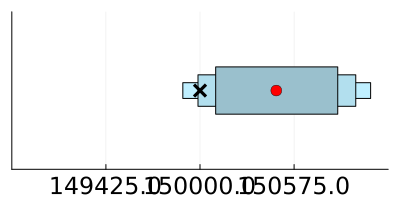

In [35]:
par_id = 1
true_par = θ
example_par = est_par

gompertz_par_names = ["K", "alpha", "m_basal", "m_size", "d_size", "d_metastasis"]
plt = bar([0.5],
    [par_quantiles.nt[9][par_id]], 
    fillto=[par_quantiles.nt[3][par_id]], 
    xlimits=(par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]),
    orientation=:h, 
    bar_width=0.1,
    color=:lightblue1, 
    label="80%CI")
bar!(plt, [0.5],
    [par_quantiles.nt[8][par_id]], 
    fillto=[par_quantiles.nt[4][par_id]], 
    xlimits=(par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]),
    orientation=:h, 
    bar_width=0.2,
    color=:lightblue2, 
    label="90%CI")
bar!(plt, [0.5],
    [par_quantiles.nt[7][par_id]], 
    fillto=[par_quantiles.nt[5][par_id]], 
    xlimits=(par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]),
    ylimits=(0.0, 1.0),
    orientation=:h, 
    bar_width=0.3, 
    color=:lightblue3,
    yticks=false,
    label="95%CI")
plot!([example_par[par_id]],[0.5], seriestype=:scatter, label="MLE", color=:red, markersize=6)
plot!([true_par[par_id]],[0.5], seriestype=:scatter, marker=:xcross, markerstrokewidth=8, label="True", color=:black, markersize=6)
x = true_par[par_id]
x_lower_limit = x-max(x-par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]-x)
x_upper_limit = x+max(x-par_quantiles.nt[2][par_id], par_quantiles.nt[10][par_id]-x)
plot!(xlimits=(x_lower_limit, x_upper_limit))
x_ticks = LinRange(x_lower_limit, x_upper_limit, 5)[2:end-1]
plot!(xticks = (x_ticks, round.(x_ticks, digits=0)))
plot!(size=(400, 200), formatter=:plain, legend=false, tickfontsize=16, legendfontsize=16, guidefontsize=16)
display(plt)
# savefig(joinpath(dir, "figures/gompertz_$(gompertz_par_names[par_id])_estimate_cis.pdf"))
